<a href="https://colab.research.google.com/github/diegulio/Breed_Recognition-to-Buscomiperro/blob/main/BMP_ModelV2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introducción
De los procesos anterior, concluí que el modelo pre entrenado EfficientNet 7 puede mejorar el anterior performance logrado anteriormente, el cual era de aproximadamente  87% en el set de testeo.

- Modelo Pre entrenado EffcientNet7 
- Fine Tuning
- Data Augmentation
- Hyperparameter tuning, optimizer, etc.

> Gran noticia: En este notebook estaré utilizando la API [weight and biases](https://wandb.ai/site) para el experiment tracking!


In [ ]:
!pip install wandb -qqq


     |████████████████████████████████| 1.8MB 8.2MB/s 
     |████████████████████████████████| 133kB 52.3MB/s 
     |████████████████████████████████| 102kB 12.6MB/s 
     |████████████████████████████████| 174kB 49.4MB/s 
     |████████████████████████████████| 71kB 10.8MB/s 


In [ ]:
import tensorflow as tf
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import load_model
from tensorflow import keras
#import wandb
#from wandb.keras import WandbCallback


In [ ]:
# Log in to your W&B account
wandb.login()

<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

# Helper Functions

In [ ]:
# Plot the validation and training data separately
def plot_loss_curves(history):
  """
  Returns separate loss curves for training and validation metrics.
  """ 
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  accuracy = history.history['accuracy']
  val_accuracy = history.history['val_accuracy']

  epochs = range(len(history.history['loss']))

  # Plot loss
  plt.plot(epochs, loss, label='training_loss')
  plt.plot(epochs, val_loss, label='val_loss')
  plt.title('Loss')
  plt.xlabel('Epochs')
  plt.legend()

  # Plot accuracy
  plt.figure()
  plt.plot(epochs, accuracy, label='training_accuracy')
  plt.plot(epochs, val_accuracy, label='val_accuracy')
  plt.title('Accuracy')
  plt.xlabel('Epochs')
  plt.legend();
  


# Convierte una carpeta en formato zip, esto para que pueda ser descargada en google colab
def zip_folder(folder_dir):
  import shutil
  shutil.make_archive(folder_dir, 'zip', folder_dir)


# Crea el modelo con API funcional
def create_model_application(model_application, preprocess_input, img_size, model_name = 'Model'):
  from tensorflow.keras.utils import plot_model

  base_model = model_application(include_top = False)
  base_model.trainable = False

  plot_model(base_model, to_file = model_name + '_plot.png')

  # Arquitectura

  inputs = tf.keras.layers.Input(img_size + (3,), name = 'Input_Layer')

  x = preprocess_input(inputs)

  x = base_model(x, training = False) # se me olvido poner trainable = False D: no me la container amarillo

  x = tf.keras.layers.GlobalAveragePooling2D(name = 'global_average_layer')(x)

  outputs = tf.keras.layers.Dense(NUM_CLASSES, activation='softmax', name = 'Output_Layer')(x)

  model = tf.keras.Model(inputs, outputs, name = model_name)

  model.compile(loss='categorical_crossentropy',
              optimizer=tf.keras.optimizers.Adam(),
              metrics=["accuracy"])

  return model



# Callbacks

In [ ]:
import datetime
import os

def create_tensorboard_callback(dir_name, experiment_name):
  # Si no esta el directorio dir_name creado, lo creamos
  if dir_name not in os.listdir():
    os.mkdir(dir_name)

  log_dir = dir_name + "/" + experiment_name + "/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
  tensorboard_callback = tf.keras.callbacks.TensorBoard(
      log_dir=log_dir
  )
  print(f"Saving TensorBoard log files to: {log_dir}")
  return tensorboard_callback


reduceLR_callback = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=2, verbose=1
)

# Directories

In [ ]:
train_dir = '/content/drive/MyDrive/Colab Data/Proyecto buscomiperro/train'
test_dir = '/content/drive/MyDrive/Colab Data/Proyecto buscomiperro/test'


# Data

In [ ]:
train_data = tf.keras.preprocessing.image_dataset_from_directory(train_dir,
                                                                 label_mode='categorical',
                                                                 image_size = (600,600),
                                                                 batch_size = 32
                                                                 )
  
test_data = tf.keras.preprocessing.image_dataset_from_directory(test_dir,
                                                                label_mode = 'categorical',
                                                                image_size = (600,600),
                                                                batch_size = 32
                                                                )

Found 8594 files belonging to 125 classes.
Found 2108 files belonging to 125 classes.


# Pretrained Model EfficientNet 7


In [ ]:
wandb.init(
    project = "buscomiperro",
    config = {
        'img_size' : (600,600),
        'batch_size' : 32,
        'num_classes' : 125,
        'activation': 'softmax',
        'model_name' : 'efficientNet7',
        'loss' : 'categorical_crossentropy',
        'optimizer' : 'adam',
        'metrics' : ['accuracy'],
        'epochs' : 5,
        'steps_per_epoch' : len(train_data),
        'train_data' : train_data,
        'val_data' : test_data,
        'val_steps' : len(test_data)
    },
    tags = ['baseline'],
    name = 'baseline'
)

In [ ]:
from tensorflow.keras.applications import EfficientNetB7
from tensorflow.keras.applications.efficientnet import preprocess_input

config = wandb.config

base_model = EfficientNetB7(include_top = False)
base_model.trainable = False

plot_model(base_model, to_file = config.model_name + '_plot.png')

# Arquitectura

inputs = tf.keras.layers.Input(tuple(config.img_size) + (3,), name = 'Input_Layer')

x = preprocess_input(inputs)

x = base_model(x, training = False) # se me olvido poner trainable = False D: no me la container amarillo

x = tf.keras.layers.GlobalAveragePooling2D(name = 'global_average_layer')(x)

outputs = tf.keras.layers.Dense(config.num_classes, activation=config.activation, name = 'Output_Layer')(x)

model = tf.keras.Model(inputs, outputs, name = config.model_name)

model.compile(loss=config.loss,
            optimizer=config.optimizer,
            metrics=config.metrics)


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.414274 to fit



In [ ]:
model.summary()

Model: "efficientNet7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Input_Layer (InputLayer)     [(None, 600, 600, 3)]     0         
_________________________________________________________________
efficientnetb7 (Functional)  (None, None, None, 2560)  64097687  
_________________________________________________________________
global_average_layer (Global (None, 2560)              0         
_________________________________________________________________
Output_Layer (Dense)         (None, 125)               320125    
Total params: 64,417,812
Trainable params: 320,125
Non-trainable params: 64,097,687
_________________________________________________________________


In [ ]:
# Fit 
history = model.fit(train_data,
                    epochs=config.epochs,
                    steps_per_epoch=config.steps_per_epoch,
                    validation_data=test_data,
                    validation_steps=config.val_steps,
                    # Add Wandb callback
                    callbacks=[WandbCallback()]) # name of log files

Epoch 1/5
269/269 [==============================] - 2084s 7s/step - loss: 1.0998 - accuracy: 0.8577 - val_loss: 0.2407 - val_accuracy: 0.9521


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 2/5
269/269 [==============================] - 945s 4s/step - loss: 0.1724 - accuracy: 0.9586 - val_loss: 0.1871 - val_accuracy: 0.9535
Epoch 3/5
269/269 [==============================] - 949s 4s/step - loss: 0.1174 - accuracy: 0.9708 - val_loss: 0.1707 - val_accuracy: 0.9554
Epoch 4/5
269/269 [==============================] - 950s 4s/step - loss: 0.0886 - accuracy: 0.9770 - val_loss: 0.1671 - val_accuracy: 0.9573
Epoch 5/5
269/269 [==============================] - 950s 4s/step - loss: 0.0695 - accuracy: 0.9836 - val_loss: 0.1683 - val_accuracy: 0.9545


In [ ]:
wandb.finish()
model.evaluate(test_data)

epoch,4
loss,0.06952
accuracy,0.98359
val_loss,0.16831
val_accuracy,0.95446
_runtime,6025
_timestamp,1623437443
_step,4
best_val_loss,0.16709
best_epoch,3


epoch,▁▃▅▆█
loss,█▂▁▁▁
accuracy,▁▇▇██
val_loss,█▃▁▁▁
val_accuracy,▁▃▅█▄
_runtime,▁▃▅▆█
_timestamp,▁▃▅▆█
_step,▁▃▅▆█


66/66 [==============================] - 187s 3s/step - loss: 0.1683 - accuracy: 0.9545


[0.16831007599830627, 0.9544591903686523]

In [ ]:
model.save('modelv2.h5')

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


# Fine Tuning

In [ ]:
model_v2 = load_model('/content/drive/MyDrive/Colab Data/Proyecto buscomiperro/modelos/modelv2.h5')

In [ ]:
model_v2.summary()

Model: "efficientNet7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Input_Layer (InputLayer)     [(None, 600, 600, 3)]     0         
_________________________________________________________________
efficientnetb7 (Functional)  (None, None, None, 2560)  64097687  
_________________________________________________________________
global_average_layer (Global (None, 2560)              0         
_________________________________________________________________
Output_Layer (Dense)         (None, 125)               320125    
Total params: 64,417,812
Trainable params: 320,125
Non-trainable params: 64,097,687
_________________________________________________________________


In [ ]:
def count_non_trainable_layers(model_v2):
  layers_non_trainable = 0
  for layer in model_v2.layers[1].layers:
    if layer.trainable == False:
      layers_non_trainable += 1

  print(f'% non trainable layers {layers_non_trainable/len(model_v2.layers[1].layers)*100}%')


In [ ]:
count_non_trainable_layers(model_v2)

% non trainable layers 99.87699876998771%


In [ ]:
for layer in model_v2.layers[1].layers:
  if layer.trainable == True:
    print(layer)

Ahora debemos descongelar algunas layers profundas del modelo pre entrenado, son las profundas ya que estas son las que se encargan de detectar patrones más específicos, en este caso de las imagenes de imageNet. En cambio, a nosotros nos interesa detectar los patrones de nuestras propias imágenes. <br>
Otro punto importante es reducir el learning rate, como  se está entrenando un modelo mucho más grande y desea readaptar los pesos preentrenados, es importante utilizar una tasa de aprendizaje más baja en esta etapa. De lo contrario, su modelo podría sobreajustarse muy rápidamente.
<br>

TODO:
- descongelar pretrained layers
- disminuir learning rate
- incorporar wandbn

## Descongelar 15% top layers del modelo pre entrenado

In [ ]:
num_trainable_layers = int(len(model_v2.layers[1].layers)*0.15)
num_trainable_layers

121

In [ ]:
for layer in model_v2.layers[1].layers[-num_trainable_layers:]:
  layer.trainable = True

In [ ]:
count_non_trainable_layers(model_v2)

% non trainable layers 84.9938499384994%


In [ ]:
from tensorflow.keras.optimizers import Adam
wandb.init(
    project = "buscomiperro",
    config = {
        'img_size' : (600,600),
        'batch_size' : 32,
        'num_classes' : 125,
        'activation': 'softmax',
        'model_name' : 'efficientNet7_FineTune',
        'loss' : 'categorical_crossentropy',
        'optimizer' : 'adam', # Disminuyo la tasa de aprendizaje
        'metrics' : ['accuracy'],
        'epochs' : 5,
        'steps_per_epoch' : len(train_data),
        'train_data' : train_data,
        'val_data' : test_data,
        'val_steps' : len(test_data)
    },
    tags = ['fine-tune'],
    name = 'fine-tune_15%layers'
)

In [ ]:
config = wandb.config
model_v2.compile(loss=config.loss,
            optimizer=config.optimizer,
            metrics=config.metrics)


In [ ]:
# Disminuyo learning rate

from keras import backend as K

K.set_value(model_v2.optimizer.lr, 0.0001/10)

print(f'new learning rate : {K.get_value(model_v2.optimizer.lr)}')

new learning rate : 9.999999747378752e-06


In [ ]:
# Fit 
history_v2 = model_v2.fit(train_data,
                    epochs=config.epochs,
                    steps_per_epoch=config.steps_per_epoch,
                    validation_data=test_data,
                    validation_steps=config.val_steps,
                    # Add Wandb callback
                    callbacks=[reduceLR_callback, WandbCallback()]) # name of log files

Epoch 1/5
269/269 [==============================] - 5898s 21s/step - loss: 0.0430 - accuracy: 0.9884 - val_loss: 0.1648 - val_accuracy: 0.9559


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 2/5
269/269 [==============================] - 2311s 9s/step - loss: 0.0221 - accuracy: 0.9941 - val_loss: 0.1758 - val_accuracy: 0.9554
Epoch 3/5
269/269 [==============================] - 2319s 9s/step - loss: 0.0133 - accuracy: 0.9974 - val_loss: 0.1891 - val_accuracy: 0.9545

Epoch 00003: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-07.
Epoch 4/5
269/269 [==============================] - 2319s 9s/step - loss: 0.0074 - accuracy: 0.9987 - val_loss: 0.1890 - val_accuracy: 0.9564
Epoch 5/5
269/269 [==============================] - 2315s 9s/step - loss: 0.0065 - accuracy: 0.9987 - val_loss: 0.1907 - val_accuracy: 0.9559

Epoch 00005: ReduceLROnPlateau reducing learning rate to 9.999999974752428e-08.


In [ ]:
model_v2.save('fine_tune_15%.h5')

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


# Data Augmentation
La idea es aplicar el aumento de los datos dentro del modelo, esto trae grandes beneficios. <br>
En base a la forma en que podrian subir las imagenes, el aumento de data que usaré será.
- Random Flip
- Random Rotation
- Random Zoom
- Random Traslation

In [ ]:
wandb.init(
    project = "buscomiperro",
    config = {
        'img_size' : (600,600),
        'batch_size' : 32,
        'num_classes' : 125,
        'activation': 'softmax',
        'model_name' : 'efficientNet7',
        'loss' : 'categorical_crossentropy',
        'optimizer' : 'adam',
        'metrics' : ['accuracy'],
        'epochs' : 5,
        'steps_per_epoch' : len(train_data),
        'train_data' : train_data,
        'val_data' : test_data,
        'val_steps' : len(test_data),
        'factor_rotation' : 1
        #'factor_zoom': (0.2,0.5),
        #'height_translation': 0.1,
        #'width_translation' : 0.1
    },
    tags = ['OnlyRotation_data_augmentation'],
    name = 'data_augmentation2'
)

wandb: Currently logged in as: diegulio (use `wandb login --relogin` to force relogin)


In [ ]:
config = wandb.config

In [ ]:
from tensorflow.keras.layers.experimental import preprocessing

# Augmentation Layer
data_augmentation = keras.Sequential([
                                      preprocessing.RandomFlip(),
                                      preprocessing.RandomRotation(factor = config['factor_rotation']), # (-360, 360) grados
                                      #preprocessing.RandomZoom(config['factor_zoom']), # Zoom out (alejarse)
                                      #preprocessing.RandomTranslation(config['height_translation'],config['width_translation'])
], name = 'data_augmentation')

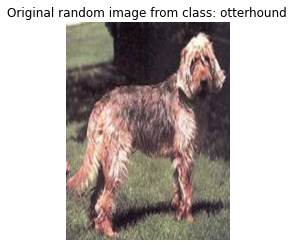

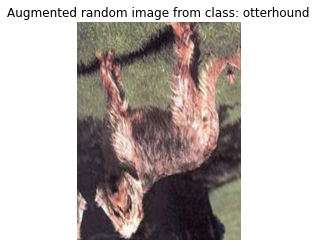

In [ ]:
# View a random image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import random

target_class = random.choice(train_data.class_names) # choose a random class
target_dir = train_dir + '/' + target_class # create the target directory
random_image = random.choice(os.listdir(target_dir)) # choose a random image from target directory
random_image_path = target_dir + "/" + random_image # create the choosen random image path
img = mpimg.imread(random_image_path) # read in the chosen target image
plt.imshow(img) # plot the target image
plt.title(f"Original random image from class: {target_class}")
plt.axis(False); # turn off the axes

# Augment the image
augmented_img = data_augmentation(tf.expand_dims(img, axis=0)) # data augmentation model requires shape (None, height, width, 3)
plt.figure()
plt.imshow(tf.squeeze(augmented_img)/255) # requires normalization after augmentation
plt.title(f"Augmented random image from class: {target_class}")
plt.axis(False);

In [ ]:
from tensorflow.keras.applications import EfficientNetB7
from tensorflow.keras.applications.efficientnet import preprocess_input


base_model = EfficientNetB7(include_top = False)
base_model.trainable = False

plot_model(base_model, to_file = config.model_name + '_plot.png')

# Arquitectura

inputs = tf.keras.layers.Input(tuple(config.img_size) + (3,), name = 'Input_Layer')

# Data Augmentation
x = data_augmentation(inputs)

x = preprocess_input(x)

x = base_model(x, training = False) # se me olvido poner trainable = False D: no me la container amarillo

x = tf.keras.layers.GlobalAveragePooling2D(name = 'global_average_layer')(x)

outputs = tf.keras.layers.Dense(config.num_classes, activation=config.activation, name = 'Output_Layer')(x)

model = tf.keras.Model(inputs, outputs, name = config.model_name)

model.compile(loss=config.loss,
            optimizer=config.optimizer,
            metrics=config.metrics)

258080768/258076736 [==============================] - 2s 0us/step
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.414274 to fit



In [ ]:
model.summary()

Model: "efficientNet7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Input_Layer (InputLayer)     [(None, 600, 600, 3)]     0         
_________________________________________________________________
data_augmentation (Sequentia (None, None, None, 3)     0         
_________________________________________________________________
efficientnetb7 (Functional)  (None, None, None, 2560)  64097687  
_________________________________________________________________
global_average_layer (Global (None, 2560)              0         
_________________________________________________________________
Output_Layer (Dense)         (None, 125)               320125    
Total params: 64,417,812
Trainable params: 320,125
Non-trainable params: 64,097,687
_________________________________________________________________


In [ ]:
# Fit 
history = model.fit(train_data,
                    epochs=config.epochs,
                    steps_per_epoch=config.steps_per_epoch,
                    validation_data=test_data,
                    validation_steps=config.val_steps,
                    # Add Wandb callback
                    callbacks=[WandbCallback()]) # name of log files

Epoch 1/5
269/269 [==============================] - 2570s 9s/step - loss: 1.7388 - accuracy: 0.6814 - val_loss: 0.3496 - val_accuracy: 0.9398


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 2/5
269/269 [==============================] - 985s 4s/step - loss: 0.6498 - accuracy: 0.8307 - val_loss: 0.2259 - val_accuracy: 0.9473
Epoch 3/5
269/269 [==============================] - 987s 4s/step - loss: 0.5245 - accuracy: 0.8511 - val_loss: 0.2050 - val_accuracy: 0.9459
Epoch 4/5
269/269 [==============================] - 986s 4s/step - loss: 0.4476 - accuracy: 0.8708 - val_loss: 0.1914 - val_accuracy: 0.9540
Epoch 5/5
269/269 [==============================] - 985s 4s/step - loss: 0.3941 - accuracy: 0.8840 - val_loss: 0.1893 - val_accuracy: 0.9502


In [ ]:
wandb.finish()
model.evaluate(test_data)

epoch,4
loss,0.39405
accuracy,0.88399
val_loss,0.18932
val_accuracy,0.95019
_runtime,6703
_timestamp,1624309899
_step,4
best_val_loss,0.18932
best_epoch,4


epoch,▁▃▅▆█
loss,█▂▂▁▁
accuracy,▁▆▇██
val_loss,█▃▂▁▁
val_accuracy,▁▅▄█▆
_runtime,▁▃▄▆█
_timestamp,▁▃▄▆█
_step,▁▃▅▆█


66/66 [==============================] - 194s 3s/step - loss: 0.1893 - accuracy: 0.9502


[0.18932464718818665, 0.9501897692680359]

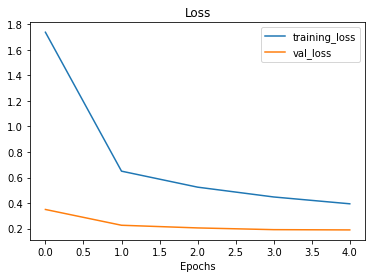

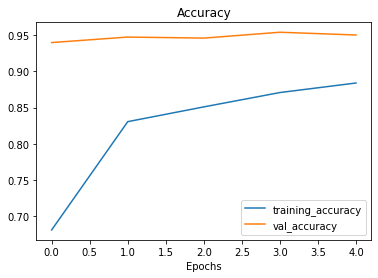

In [ ]:
plot_loss_curves(history)

In [ ]:
model.save('modelv2_augmented.h5')

# Fine tuning + DataAugmentation

In [ ]:
BASE_LAYER = 2 # ahora es el layer 2
# Definimos nuestra misma función utilizada en Fine Tuning anterior
def count_non_trainable_layers(model_v2):
  layers_non_trainable = 0
  for layer in model_v2.layers[BASE_LAYER].layers: 
    if layer.trainable == False:
      layers_non_trainable += 1

  print(f'% non trainable layers {layers_non_trainable/len(model_v2.layers[BASE_LAYER].layers)*100}%')


In [ ]:
count_non_trainable_layers(model)

% non trainable layers 100.0%


In [ ]:
# Descongelamos las ultimas 15% layers
num_trainable_layers = int(len(model.layers[BASE_LAYER].layers)*0.15)
print('num trainable layers: ', num_trainable_layers)

for layer in model.layers[BASE_LAYER].layers[-num_trainable_layers:]:
  layer.trainable = True



num trainable layers:  121


In [ ]:
count_non_trainable_layers(model)

% non trainable layers 85.11685116851169%


In [ ]:
wandb.init(
    project = "buscomiperro",
    config = {
        'img_size' : (600,600),
        'batch_size' : 32,
        'num_classes' : 125,
        'activation': 'softmax',
        'model_name' : 'efficientNet7',
        'loss' : 'categorical_crossentropy',
        'optimizer' : 'adam',
        'metrics' : ['accuracy'],
        'epochs' : 10, # Considerando las primeras 5 pre fine tune
        'steps_per_epoch' : len(train_data),
        'train_data' : train_data,
        'val_data' : test_data,
        'val_steps' : len(test_data),
        'factor_rotation' : 1
        #'factor_zoom': (0.2,0.5),
        #'height_translation': 0.1,
        #'width_translation' : 0.1
    },
    tags = ['OnlyRotation_data_augmentation'],
    name = 'data_augmentation2_finetune15%'
)

In [ ]:
config = wandb.config
model.compile(loss=config.loss,
            optimizer=config.optimizer,
            metrics=config.metrics)

In [ ]:
# Disminuyo learning rate

from keras import backend as K

K.set_value(model.optimizer.lr, 0.0001/10)

print(f'new learning rate : {K.get_value(model.optimizer.lr)}')

new learning rate : 9.999999747378752e-06


In [ ]:
# Fit 
history_fine = model.fit(train_data,
                    epochs=config.epochs,
                    initial_epoch = history.epoch[-1], # comienzo desde la última epoch pre fine tune
                    steps_per_epoch=config.steps_per_epoch,
                    validation_data=test_data,
                    validation_steps=config.val_steps,
            
                    # Add Wandb callback
                    callbacks=[reduceLR_callback, WandbCallback()]) # name of log files

Epoch 5/10
269/269 [==============================] - 1003s 4s/step - loss: 0.3322 - accuracy: 0.9066 - val_loss: 0.1878 - val_accuracy: 0.9507


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 6/10
269/269 [==============================] - 984s 4s/step - loss: 0.3207 - accuracy: 0.9109 - val_loss: 0.1867 - val_accuracy: 0.9511
Epoch 7/10
269/269 [==============================] - 985s 4s/step - loss: 0.3224 - accuracy: 0.9083 - val_loss: 0.1857 - val_accuracy: 0.9507
Epoch 8/10
269/269 [==============================] - 985s 4s/step - loss: 0.3177 - accuracy: 0.9089 - val_loss: 0.1848 - val_accuracy: 0.9511
Epoch 9/10
269/269 [==============================] - 984s 4s/step - loss: 0.3168 - accuracy: 0.9112 - val_loss: 0.1842 - val_accuracy: 0.9511
Epoch 10/10
269/269 [==============================] - 984s 4s/step - loss: 0.3115 - accuracy: 0.9113 - val_loss: 0.1837 - val_accuracy: 0.9507


In [ ]:
initial_epochs = 5
fine_tune_epochs = 5
total_epochs =  initial_epochs + fine_tune_epochs

# Juntamos los historiales para graficar 
acc = history.history['accuracy'] + history_fine.history['accuracy']
val_acc = history.history['val_accuracy'] + history_fine.history['val_accuracy']

loss = history.history['loss'] + history_fine.history['loss']
val_loss = history.history['val_loss'] + history_fine.history['val_loss']


plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

# Exploración resultados 

In [ ]:
modelv2 = load_model('/content/drive/MyDrive/Colab Data/Proyecto buscomiperro/modelos/fine_tune_15%.h5')

In [ ]:
#modelv2.evaluate(test_data)

In [ ]:
def plot_image(model, target_class = None, class_names = test_data.class_names):
  import os
  import random
  from keras.preprocessing.image import load_img
  from keras.preprocessing.image import img_to_array
  import matplotlib.pyplot as plt
  import numpy as np

  if target_class == None:
    target_class = random.choice(class_names)



  
  target_class_dir = os.path.join(test_dir, target_class)
  target_image = random.choice(os.listdir(target_class_dir)) 
  target_dir = os.path.join(test_dir,target_class_dir,target_image)

  img = load_img(target_dir, target_size = (600,600))
  img_array = tf.expand_dims(img_to_array(img), axis = 0)

  
  predictions_array = modelv2.predict(img_array)[0]

  fig = plt.figure(figsize = (30, 5))

  fig.add_subplot(1,2,1)
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  plt.imshow(img, cmap=plt.cm.binary)

  predicted_idx = np.argmax(predictions_array)
  predicted_label = class_names[predicted_idx]
  
  if predicted_label == target_class:
    color = 'blue'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ({})".format(class_names[predicted_idx],
                                100*np.max(predictions_array),
                                class_names[class_names.index(target_class)]),
                                color=color)
  
  
  best_10 = predictions_array.argsort()[-10:][::-1]
  best_10_labels = []
  for idx in best_10:
    best_10_labels.append(class_names[idx])
   
  fig.add_subplot(1,2,2)
  plt.xticks(range(10), best_10_labels, rotation = 20)
  #plt.yticks([])
  thisplot = plt.bar(range(10), predictions_array[best_10], color="#777777")
  plt.ylim([0, 1])
  predicted_label = np.argmax(best_10)

  thisplot[0].set_color('red')
  #thisplot[target_class].set_color('blue')
  plt.show()


In [ ]:
test_data.class_names

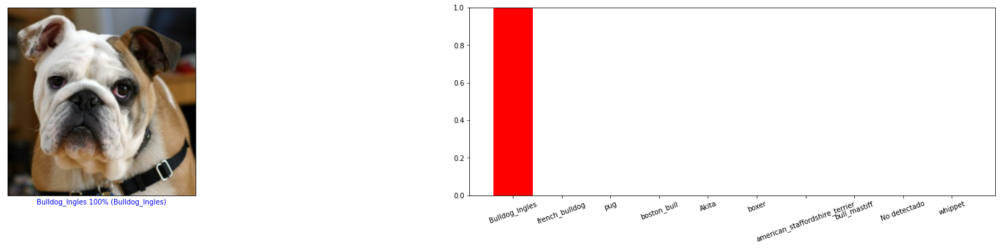

In [ ]:
plot_image(modelv2, target_class='collie')

# Exploración Predicciones Erróneas

In [ ]:
def plot_wrong_predictions(model, target_dir, target_class , class_names = test_data.class_names):
  import os
  import random
  from keras.preprocessing.image import load_img
  from keras.preprocessing.image import img_to_array
  import matplotlib.pyplot as plt
  import numpy as np

  
  

  img = load_img(target_dir, target_size = (600,600))
  img_array = tf.expand_dims(img_to_array(img), axis = 0)

  
  predictions_array = modelv2.predict(img_array)[0]

  predicted_idx = np.argmax(predictions_array)
  predicted_label = class_names[predicted_idx]

  if predicted_label != target_class:
    fig = plt.figure(figsize = (30, 5))

    fig.add_subplot(1,2,1)
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

    plt.imshow(img, cmap=plt.cm.binary)

    
    
    if predicted_label == target_class:
      color = 'blue'
    else:
      color = 'red'

    plt.xlabel("{} {:2.0f}% ({})".format(class_names[predicted_idx],
                                  100*np.max(predictions_array),
                                  class_names[class_names.index(target_class)]),
                                  color=color)
    
    
    best_10 = predictions_array.argsort()[-10:][::-1]
    best_10_labels = []
    for idx in best_10:
      best_10_labels.append(class_names[idx])
    
    fig.add_subplot(1,2,2)
    plt.xticks(range(10), best_10_labels, rotation = 20)
    #plt.yticks([])
    thisplot = plt.bar(range(10), predictions_array[best_10], color="#777777")
    plt.ylim([0, 1])
    predicted_label = np.argmax(best_10)

    thisplot[0].set_color('red')
    #thisplot[target_class].set_color('blue')
    plt.show()
    return target_class

## Test data wrong predictions :


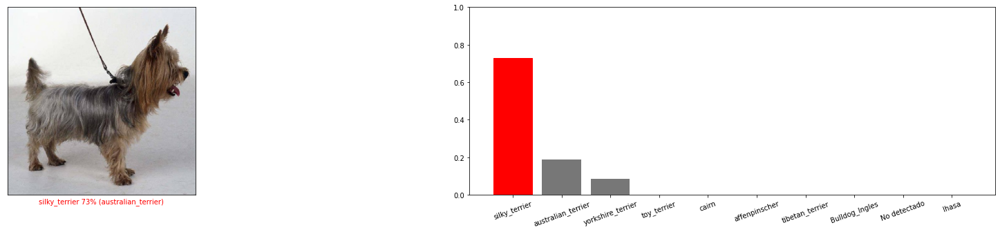

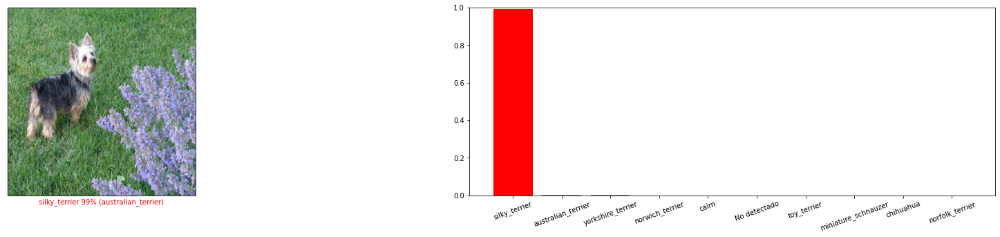

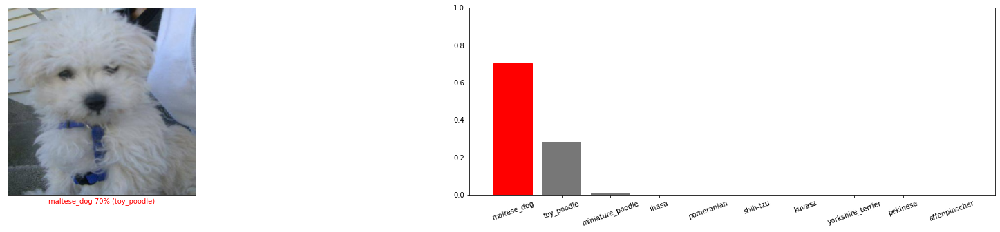

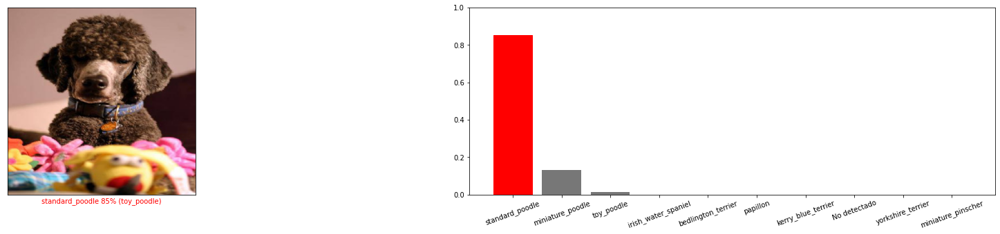

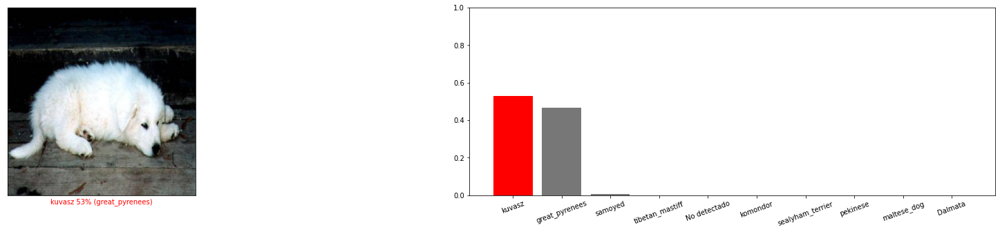

...

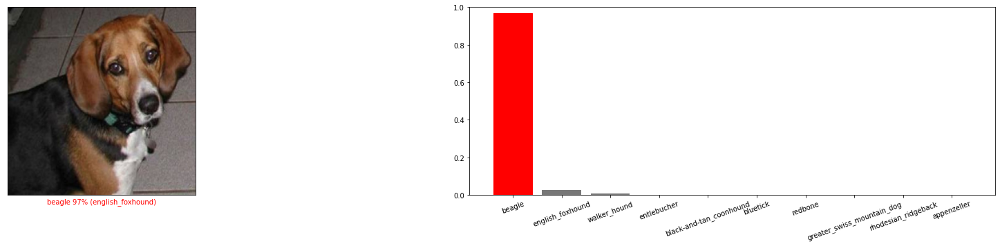

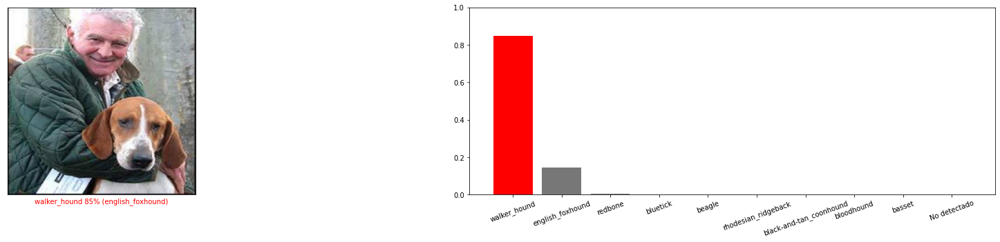

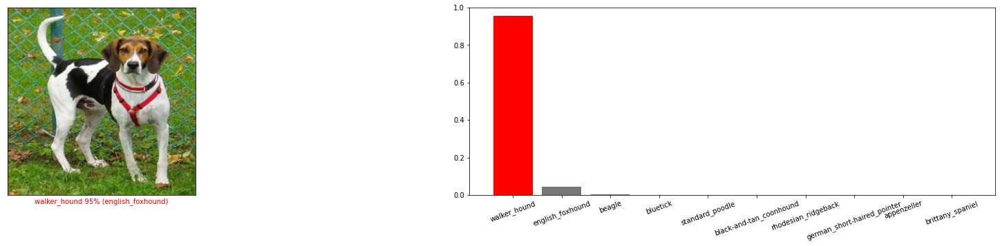

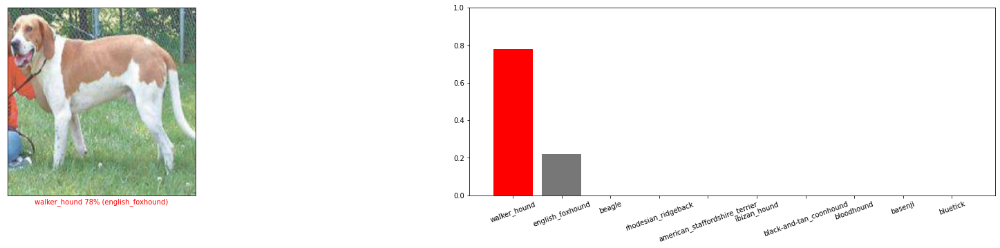

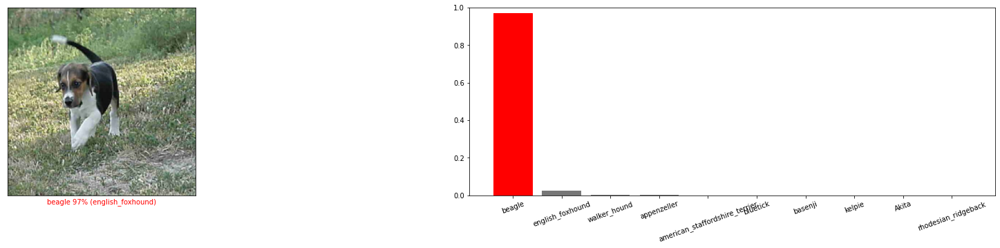

In [ ]:
import os 
for breed in os.listdir(test_dir):
  if breed == '.DS_Store':
    continue
  for dog in os.listdir(os.path.join(test_dir, breed)):
    if dog == '.DS_Store':
      continue
    img_path = os.path.join(test_dir,breed,dog)
    plot_wrong_predictions(modelv2, img_path, breed , class_names = test_data.class_names)



### Conclusiones
De lo observado en las predictiones incorrectas del test set podemos ver que :

- Silky terrier y australian terrier se parecen mucho, para efectos de la implementación en Chile, no sería problemático juntar ambos y dejarlos como `"terrier"`
- Un caso similiar a la observación anterior sucede con los poodle, podriamos dejar todos los tipos de poodle como `"..poodle.."` ✅
- Kuvasz y great_pyrenees se parecen mucho, en Chile la raza Kuvasz es muy poco común, por lo que se podría optar por eliminarla.
- La Raza `Lhasa` es muy parecida a Shit-zu, en Chile la más conocida es `"Shith-zu"` ✅ 
- El algoritmo tiene dificultades con la raza `Maltés`. ✅
- La raza `"..springer.."` se podria agrupar. ✅
- Hay un misslabel en `dhole` ✅
- Misslabel en `japanese_spaniel`, siendo `shih-tzu` ✅
- misslabel en `walker_hound` siendo `?`✅
- `english_foxhound` es muy similar a `walker_hound`. Podria dejarse como `hound` ✅
- misslabel en `newfoundland` siendo `?` ✅
- misslabel en `newfoundland` siendo `flat coated retriever` ✅
- misslabel en `black and tan coonhound` siendo `bloodhound` ✅
- `malamute` es muy similar a `siberian_husky`. En Chile es más común `siberian_husky` ✅
- un sospechoso misslabel en `viszla` siendo `labrador_retriever` ✅
- misslabel en `doberman` siendo `?` ✅
- muchos misslabel `collie` siendo `border_collie` ✅
- `shetland_sheepdog` muy similar a `collie`. En Chile se conoce más como `collie` ✅
- misslabel en `shih-tzu` siendo `?` ✅
- misslabel `sussex_spaniel` siendo `clumber`✅
- `american staffordshire terrier` muy similar a `staffordshire bull terrier` ✅
- misslabel en `american staffordshire terrier` siendo `boxer` ✅
- sospechoso misslabel `lakeland_terrier` siendo `airedale` ✅
- `wire hair fox terrier` muy similar a `lakeland_terrier` ✅
- varios misslabel `eskimo dog` siendo `siberian_husky`✅
- multi razas en `golden_retriever` ✅
- `miniature_schaunzer` muy similar a `standard_schnauzer`. ✅
- misslabel en `keeshound` siendo `samoyedo` ✅
- misslabel en `sealyham_terrier` siendo `scotch_terrier`. De todas formas son muy similares. ✅
- misslabel en `bull_mastif` siendo `bulldog_ingles` ✅
- misslabel en `bull_mastif` siendo `?`
- multiraza en `irish_terrier`✅
- multiraza en `redbone` ✅
- varios misslabel en `english_foxhound` siendo `beagle` ✅
- `english_foxhound` muy similar a `walker_hound` ✅

Es muy importante notar la cantidad de razas misllabeled que hay en el conjunto de testeo, esto es aún más preocupante si sucede también en el train set, por lo que tendremo que evaluarlo.

## Train data wrong predictions :

Analizando Raza :  boston_bull
0.008%
Analizando Raza :  whippet
0.016%
Analizando Raza :  irish_setter
0.024%
Analizando Raza :  norwich_terrier
0.032%
Analizando Raza :  maltese_dog
0.04%
Analizando Raza :  kelpie
0.048%
Analizando Raza :  great_pyrenees
0.056%
Analizando Raza :  toy_poodle
0.064%
Analizando Raza :  rottweiler
0.072%
Analizando Raza :  australian_terrier
0.08%
Analizando Raza :  schipperke
0.088%
Analizando Raza :  leonberg
0.096%
Analizando Raza :  african_hunting_dog
0.104%
Analizando Raza :  welsh_springer_spaniel
0.112%
Analizando Raza :  pomeranian
0.12%
Analizando Raza :  blenheim_spaniel
0.128%
Analizando Raza :  basenji
0.136%
Analizando Raza :  No detectado
0.144%
Analizando Raza :  komondor
0.152%
Analizando Raza :  irish_wolfhound
0.16%
Analizando Raza :  pekinese
0.168%
Analizando Raza :  gato
0.176%
Analizando Raza :  kerry_blue_terrier
0.184%
Analizando Raza :  yorkshire_terrier
0.192%
Analizando Raza :  lhasa
0.2%
Analizando Raza :  miniature_pinscher


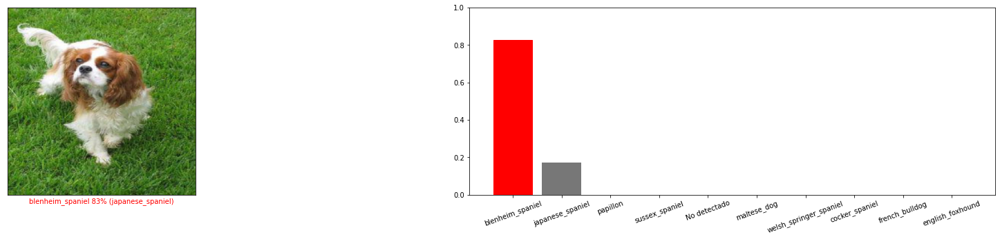

Analizando Raza :  walker_hound
0.24%
Analizando Raza :  basset
0.248%
Analizando Raza :  standard_poodle
0.256%
Analizando Raza :  saint_bernard
0.264%
Analizando Raza :  newfoundland
0.272%
Analizando Raza :  pug
0.28%
Analizando Raza :  chihuahua
0.288%
Analizando Raza :  beagle
0.296%
Analizando Raza :  black-and-tan_coonhound
0.304%
Analizando Raza :  scottish_deerhound
0.312%
Analizando Raza :  cairn
0.32%
Analizando Raza :  malamute
0.328%
Analizando Raza :  afghan_hound
0.336%
Analizando Raza :  vizsla
0.344%
Analizando Raza :  collie
0.352%
Analizando Raza :  italian_greyhound
0.36%
Analizando Raza :  english_springer
0.368%
Analizando Raza :  silky_terrier
0.376%
Analizando Raza :  west_highland_white_terrier
0.384%
Analizando Raza :  weimaraner
0.392%
Analizando Raza :  brittany_spaniel
0.4%
Analizando Raza :  affenpinscher
0.408%
Analizando Raza :  pembroke
0.416%
Analizando Raza :  papillon
0.424%


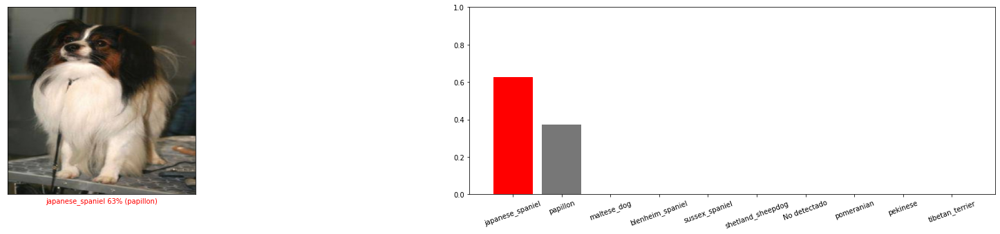

Analizando Raza :  doberman
0.432%
Analizando Raza :  norwegian_elkhound
0.44%


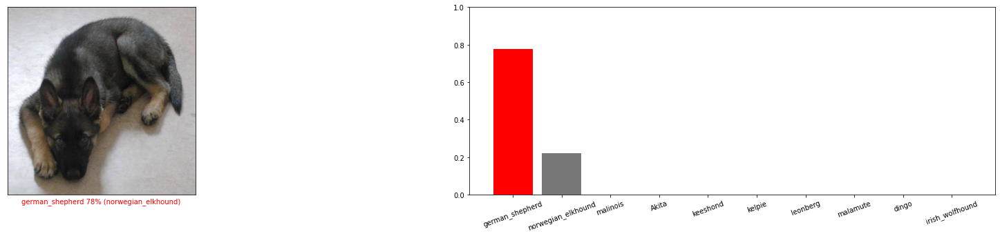

Analizando Raza :  flat-coated_retriever
0.448%
Analizando Raza :  ibizan_hound
0.456%
Analizando Raza :  shih-tzu
0.464%
Analizando Raza :  cocker_spaniel
0.472%
Analizando Raza :  soft-coated_wheaten_terrier
0.48%
Analizando Raza :  rhodesian_ridgeback
0.488%
Analizando Raza :  samoyed
0.496%
Analizando Raza :  sussex_spaniel
0.504%
Analizando Raza :  american_staffordshire_terrier
0.512%
Analizando Raza :  brabancon_griffon
0.52%
Analizando Raza :  groenendael
0.528%
Analizando Raza :  shetland_sheepdog
0.536%
Analizando Raza :  bouvier_des_flandres
0.544%


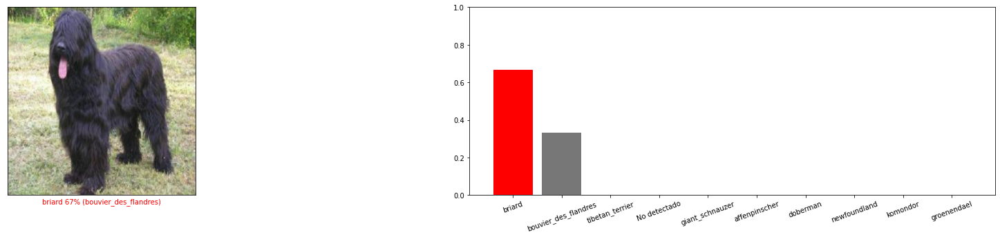

Analizando Raza :  golden_retriever
0.552%
Analizando Raza :  eskimo_dog
0.56%
Analizando Raza :  giant_schnauzer
0.568%


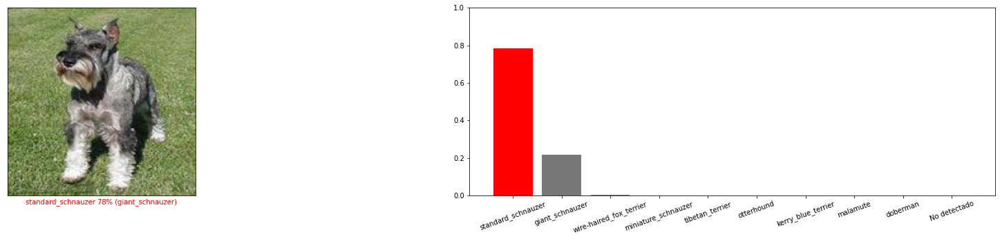

Analizando Raza :  lakeland_terrier
0.576%
Analizando Raza :  miniature_poodle
0.584%


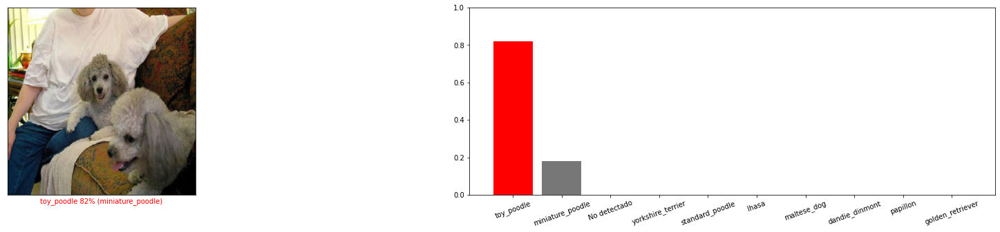

Analizando Raza :  tibetan_terrier
0.592%
Analizando Raza :  staffordshire_bullterrier
0.6%
Analizando Raza :  bedlington_terrier
0.608%
Analizando Raza :  saluki
0.616%
Analizando Raza :  miniature_schnauzer
0.624%
Analizando Raza :  airedale
0.632%
Analizando Raza :  chow
0.64%
Analizando Raza :  appenzeller
0.648%
Analizando Raza :  curly-coated_retriever
0.656%
Analizando Raza :  border_collie
0.664%
Analizando Raza :  dingo
0.672%
Analizando Raza :  siberian_husky
0.68%


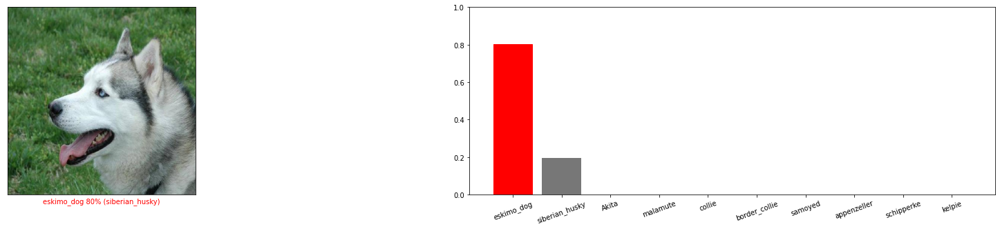

Analizando Raza :  borzoi
0.688%
Analizando Raza :  border_terrier
0.696%
Analizando Raza :  otterhound
0.704%


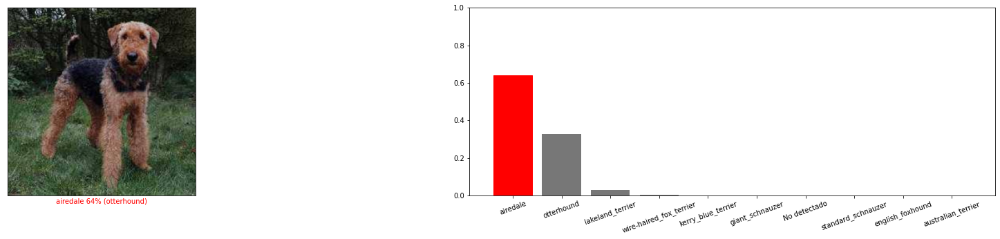

Analizando Raza :  keeshond
0.712%
Analizando Raza :  french_bulldog
0.72%
Analizando Raza :  toy_terrier
0.728%
Analizando Raza :  malinois
0.736%
Analizando Raza :  kuvasz
0.744%
Analizando Raza :  great_dane
0.752%
Analizando Raza :  bernese_mountain_dog
0.76%


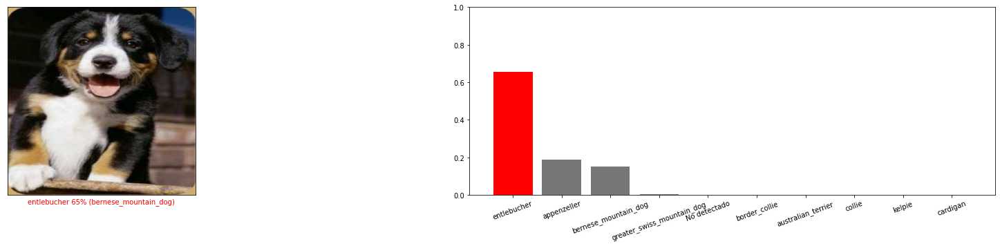

Analizando Raza :  labrador_retriever
0.768%
Analizando Raza :  chesapeake_bay_retriever
0.776%
Analizando Raza :  german_shepherd
0.784%
Analizando Raza :  sealyham_terrier
0.792%


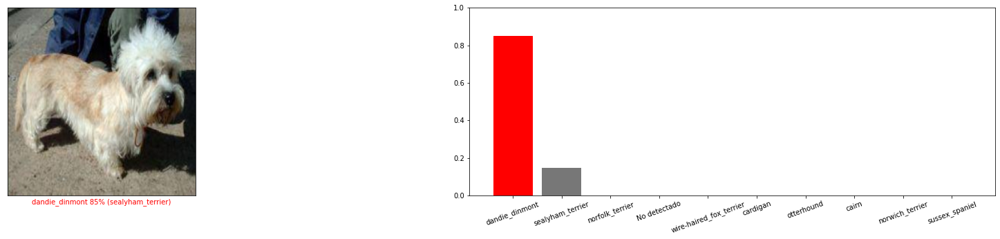

Analizando Raza :  briard
0.8%
Analizando Raza :  norfolk_terrier
0.808%


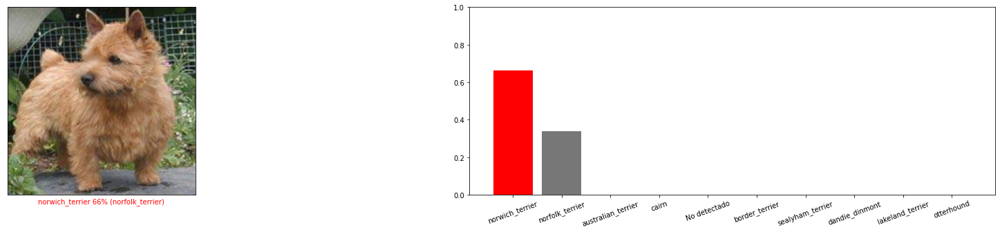

Analizando Raza :  wire-haired_fox_terrier
0.816%


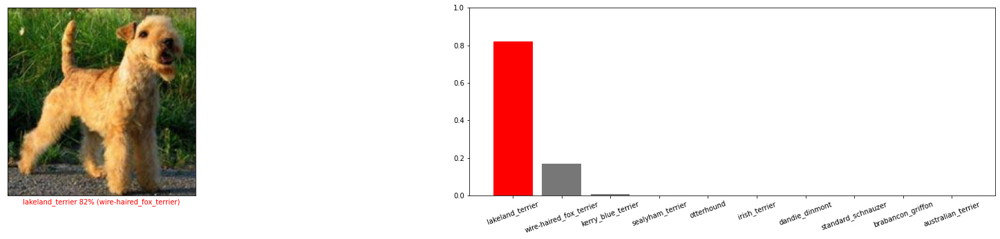

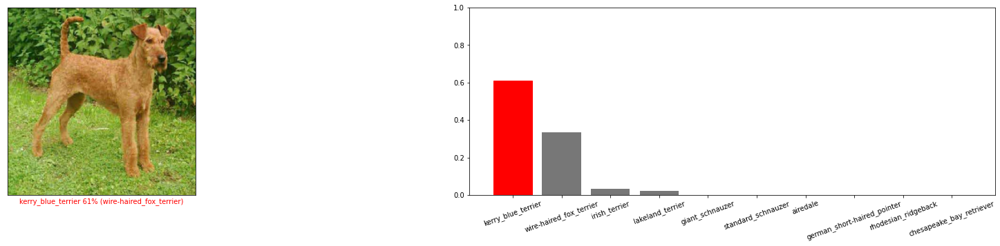

Analizando Raza :  dandie_dinmont
0.824%
Analizando Raza :  bull_mastiff
0.832%
Analizando Raza :  irish_water_spaniel
0.84%
Analizando Raza :  tibetan_mastiff
0.848%
Analizando Raza :  bloodhound
0.856%
Analizando Raza :  cardigan
0.864%
Analizando Raza :  scotch_terrier
0.872%
Analizando Raza :  entlebucher
0.88%
Analizando Raza :  clumber
0.888%
Analizando Raza :  boxer
0.896%
Analizando Raza :  old_english_sheepdog
0.904%
Analizando Raza :  bluetick
0.912%
Analizando Raza :  irish_terrier
0.92%
Analizando Raza :  mexican_hairless
0.928%
Analizando Raza :  greater_swiss_mountain_dog
0.936%
Analizando Raza :  english_foxhound
0.944%


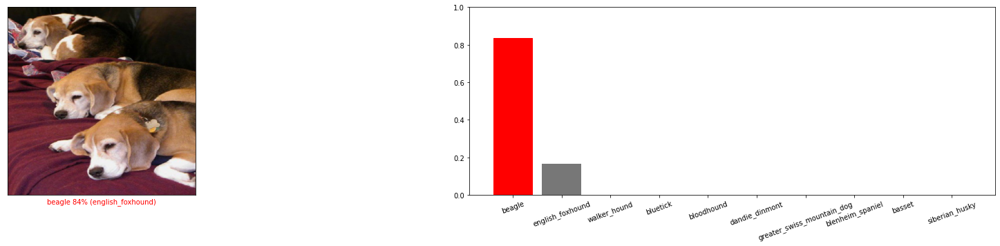

Analizando Raza :  german_short-haired_pointer
0.952%
Analizando Raza :  english_setter
0.96%
Analizando Raza :  redbone
0.968%
Analizando Raza :  gordon_setter
0.976%
Analizando Raza :  Bulldog_Ingles
0.984%
Analizando Raza :  Akita
0.992%
Analizando Raza :  Dalmata
1.0%


In [ ]:
import os 
error_breeds = []
count = 1
for breed in os.listdir(train_dir):
  if breed == '.DS_Store':
    continue
  print("Analizando Raza : ", breed)
  print(f"{count/125*100}%")
  for dog in os.listdir(os.path.join(train_dir, breed)):
    if dog == '.DS_Store':
      continue
    img_path = os.path.join(train_dir,breed,dog)
    error_breed = plot_wrong_predictions(modelv2, img_path, breed , class_names = train_data.class_names)
    error_breeds.append(error_breed)
  count += 1


### Conclusiones
Vemos que muchas de las observaciones del conjunto de testeo se repiten. Finalmente, según esto basaremos nuestras medidas a tomar.

#Conclusiones
Acciones a realizar en base a lo estudiado anteriormente:

- `standard_poodle`,`miniature_poodle`,`toy_poodle` = `poodle`
- `Lhasa` Eliminada. Se deja `shih_tzu`
- `welsh_springer_spaniel`,`english_springer` = `springer_spaniel`
- Se elimina `walker_hound`. Se deja `english_foxhound`
- Se elimina `malamute` y `eskimo_dog`. Se deja `siberian_husky`
- Se elimina `sheetland_sheepdog`. Se deja `collie`.
- `american staffordshire terrier`,`staffordshire bull terrier` = `staffordshire_terrier`
- Se elimina `lakeland_terrier`. Se deja `wire_haired_fox_terrier`
- `standar_schnauzer`,`miniature_schnauzer`,`giant_schnauzer` = `schnauzer`

Estos cambios se han realizado tanto en el test set como en el train set. Además en el trainset se revisó rápidamente, clase por clase, los misslabels **evidentes**.

Los nuevos conjuntos de datos ahora son nombrados `train_v3` y `test_v3`. Y serán utilizados en el `modelV3`